# Using the Train Dataset

# Dataset Description

The data scientists at BigMart have collected 2013 sales data for 1559 products across 10 stores in different cities.Certain attributes of each product and store have been defined. The aim is to build a predictive model and find out the sales of each product at a particular store.The target variable for this dataset is 'Item_Outlet_Sales'.

# Importing the dataset

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from scipy.stats import zscore
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')

# Loading the dataset

In [6]:
df=pd.read_csv('bigdatamart_train.csv')

In [7]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [8]:
df.shape

(8523, 12)

In [9]:
df.columns

Index(['Item_Identifier', 'Item_Weight', 'Item_Fat_Content', 'Item_Visibility',
       'Item_Type', 'Item_MRP', 'Outlet_Identifier',
       'Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type',
       'Outlet_Type', 'Item_Outlet_Sales'],
      dtype='object')

# Checking the datatypes

In [10]:
df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
dtype: object

In [11]:
pd.set_option('display.max_rows',None)

In [12]:
df['Item_Outlet_Sales'].unique()

array([3735.138 ,  443.4228, 2097.27  , ..., 7182.6504, 3608.636 ,
       2778.3834])

# Checking the null values

In [13]:
df.isnull().sum()

Item_Identifier                 0
Item_Weight                  1463
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  2410
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales               0
dtype: int64

Null values are present in two columns 'Item_Weight' and 'Outlet_Size'.We have to remove those null values.

By taking median and mode,we can remove the null values.

In [14]:
#df['Item_Weight']=df['Item_Weight'].fillna(np.mean(df['Item_Weight']))

In [15]:
from sklearn.impute import SimpleImputer
imp=SimpleImputer(strategy='most_frequent')
df['Outlet_Size']=imp.fit_transform(df['Outlet_Size'].values.reshape(-1,1))

In [16]:
imp=SimpleImputer(strategy='median')
df['Item_Weight']=imp.fit_transform(df['Item_Weight'].values.reshape(-1,1))

In [17]:
df.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
Item_Outlet_Sales            0
dtype: int64

Now there are no null values

In [18]:
df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
dtype: object

# Checking the distribution of the continuous value of the float type columns



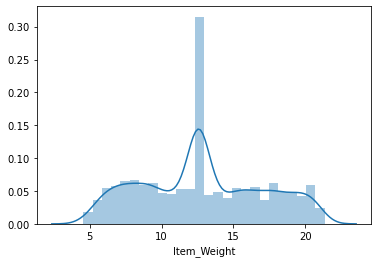

In [19]:
sns.distplot(df['Item_Weight'],kde=True)

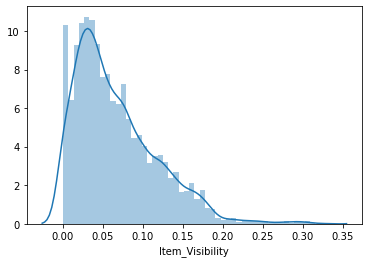

In [20]:
sns.distplot(df['Item_Visibility'],kde=True)

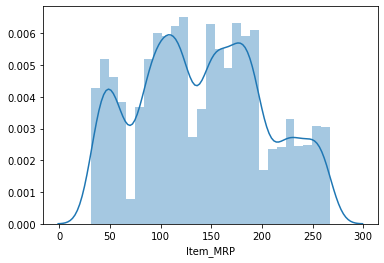

In [21]:
sns.distplot(df['Item_MRP'],kde=True)

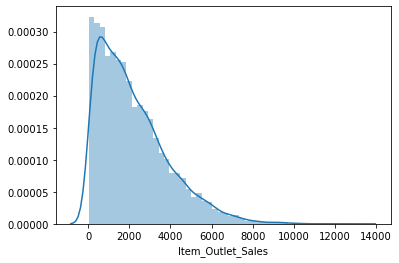

In [22]:
sns.distplot(df['Item_Outlet_Sales'],kde=True)

# Encoding of DataFrame

Since the dataset has string values,we will use the encoding techniques to convert the string data to numerical one

In [23]:
from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

In [24]:
for i in df.columns:
    if df[i].dtypes=='object':
        df[i]=enc.fit_transform(df[i].values.reshape(-1,1))

In [25]:
df

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,156.0,9.300,1.0,0.016047,4.0,249.8092,9.0,1999,1.0,0.0,1.0,3735.1380
1,8.0,5.920,2.0,0.019278,14.0,48.2692,3.0,2009,1.0,2.0,2.0,443.4228
2,662.0,17.500,1.0,0.016760,10.0,141.6180,9.0,1999,1.0,0.0,1.0,2097.2700
3,1121.0,19.200,2.0,0.000000,6.0,182.0950,0.0,1998,1.0,2.0,0.0,732.3800
4,1297.0,8.930,1.0,0.000000,9.0,53.8614,1.0,1987,0.0,2.0,1.0,994.7052
5,758.0,10.395,2.0,0.000000,0.0,51.4008,3.0,2009,1.0,2.0,2.0,556.6088
6,696.0,13.650,2.0,0.012741,13.0,57.6588,1.0,1987,0.0,2.0,1.0,343.5528
7,738.0,12.600,1.0,0.127470,13.0,107.7622,5.0,1985,1.0,2.0,3.0,4022.7636
8,440.0,16.200,2.0,0.016687,5.0,96.9726,7.0,2002,1.0,1.0,1.0,1076.5986
9,990.0,19.200,2.0,0.094450,5.0,187.8214,2.0,2007,1.0,1.0,1.0,4710.5350


# Describe the dataset

In [26]:
df.describe()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
count,8523.000000,8523.00000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000,8523.000000
mean,779.714889,12.81342,1.369354,0.066132,7.226681,140.992782,4.722281,1997.831867,1.170832,1.112871,1.201220,2181.288914
std,449.222377,4.22724,0.644810,0.051598,4.209990,62.275067,2.837201,8.371760,0.600327,0.812757,0.796459,1706.499616
min,0.000000,4.55500,0.000000,0.000000,0.000000,31.290000,0.000000,1985.000000,0.000000,0.000000,0.000000,33.290000
25%,395.500000,9.31000,1.000000,0.026989,4.000000,93.826500,2.000000,1987.000000,1.000000,0.000000,1.000000,834.247400
50%,783.000000,12.60000,1.000000,0.053931,6.000000,143.012800,5.000000,1999.000000,1.000000,1.000000,1.000000,1794.331000
75%,1167.000000,16.00000,2.000000,0.094585,10.000000,185.643700,7.000000,2004.000000,2.000000,2.000000,1.000000,3101.296400
max,1558.000000,21.35000,4.000000,0.328391,15.000000,266.888400,9.000000,2009.000000,2.000000,2.000000,3.000000,13086.964800


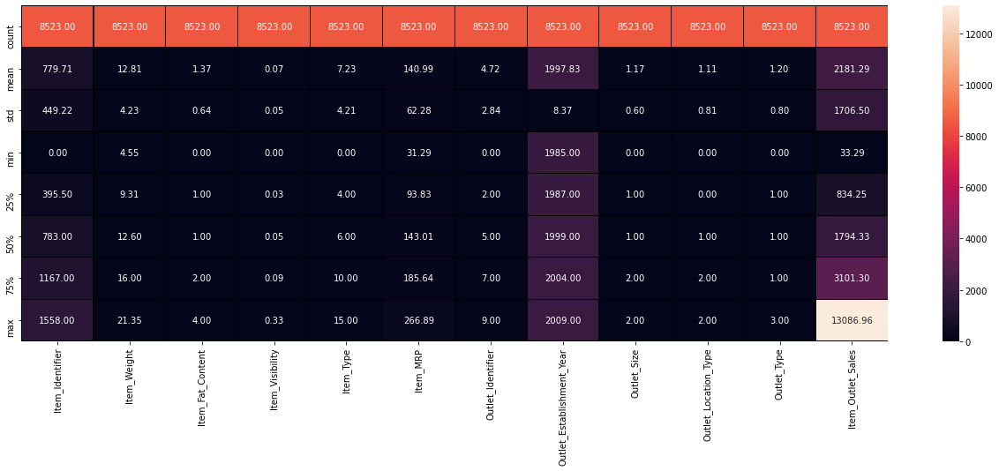

In [27]:
plt.figure(figsize=(22,7))
sns.heatmap(df.describe(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

# Correlation of the columns with the target column:

In [28]:
df.corr()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
Item_Identifier,1.000000,0.044218,-0.098114,-0.025482,-0.017973,0.012853,-0.008602,-0.012772,0.001389,0.003656,-0.001178,0.002869
Item_Weight,0.044218,1.000000,-0.017255,-0.014168,0.028038,0.024951,-0.007666,0.007739,-0.010536,0.001958,-0.009973,0.009693
Item_Fat_Content,-0.098114,-0.017255,1.000000,0.034042,-0.115958,-0.000876,-0.002357,-0.000189,-0.012058,-0.004102,-0.004214,0.009800
Item_Visibility,-0.025482,-0.014168,0.034042,1.000000,-0.035249,-0.001315,-0.100439,-0.074834,0.069309,-0.028099,-0.173468,-0.128625
Item_Type,-0.017973,0.028038,-0.115958,-0.035249,1.000000,0.032651,0.001656,0.004970,-0.001859,0.003084,0.003053,0.017048
Item_MRP,0.012853,0.024951,-0.000876,-0.001315,0.032651,1.000000,0.003319,0.005020,0.006059,0.000232,-0.001975,0.567574
Outlet_Identifier,-0.008602,-0.007666,-0.002357,-0.100439,0.001656,0.003319,1.000000,0.079035,0.504603,-0.716176,0.099873,0.162325
Outlet_Establishment_Year,-0.012772,0.007739,-0.000189,-0.074834,0.004970,0.005020,0.079035,1.000000,0.193389,-0.089216,-0.122304,-0.049135
Outlet_Size,0.001389,-0.010536,-0.012058,0.069309,-0.001859,0.006059,0.504603,0.193389,1.000000,-0.614311,-0.201483,-0.086182
Outlet_Location_Type,0.003656,0.001958,-0.004102,-0.028099,0.003084,0.000232,-0.716176,-0.089216,-0.614311,1.000000,0.467219,0.089367


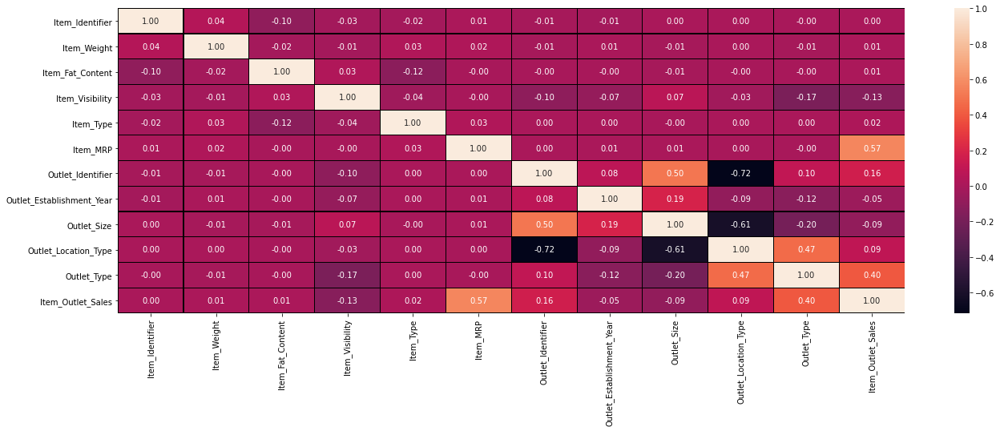

In [29]:
plt.figure(figsize=(22,7))
sns.heatmap(df.corr(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

From the heatmap,it can be seen that 'Item_MRP' and 'Outlet_Type' are more positively correlated with the target column 'Item_Outlet_Sales'.

Checking the columns which are positively and negatively correlated with the target columns

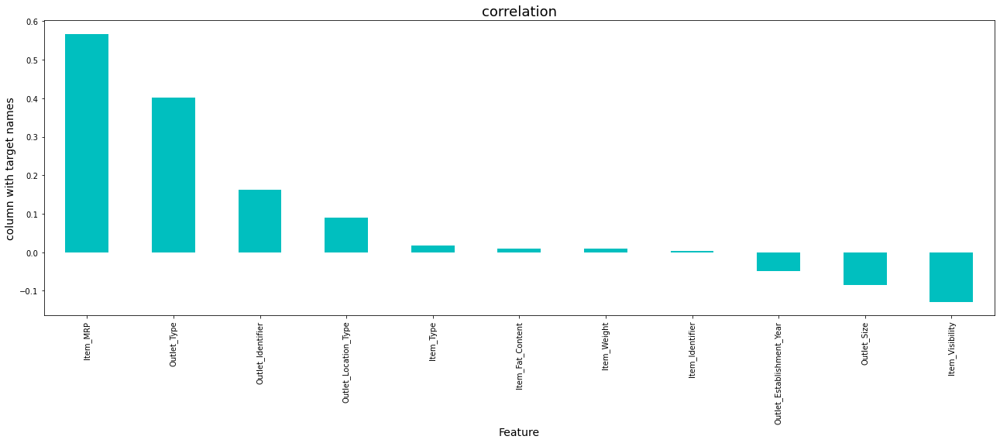

In [30]:
plt.figure(figsize=(22,7))
df.corr()['Item_Outlet_Sales'].sort_values(ascending=False).drop(['Item_Outlet_Sales']).plot(kind='bar',color='c')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

# Checking Skewness

In [31]:
df.skew()

Item_Identifier             -0.008877
Item_Weight                  0.121845
Item_Fat_Content             0.994824
Item_Visibility              1.167091
Item_Type                    0.101655
Item_MRP                     0.127202
Outlet_Identifier           -0.059861
Outlet_Establishment_Year   -0.396641
Outlet_Size                 -0.087072
Outlet_Location_Type        -0.209093
Outlet_Type                  0.927438
Item_Outlet_Sales            1.177531
dtype: float64

Keeping +/-0.5 as the range for skewness,here are the columns which does not lie within this range.

We only have to remove skewness from a single column 'Item_Visibility' as it is a float type.We dont go for skewness removal if the column is object type.

In [32]:
from sklearn.preprocessing import PowerTransformer
df_new=PowerTransformer(method='yeo-johnson')
df_new1=df_new.fit_transform(df.iloc[:,3:4])

In [33]:
df_N=pd.DataFrame(df_new1)
df_N

,0
0,-1.146886
1,-1.037100
2,-1.122375
3,-1.745551
4,-1.745551
5,-1.745551
6,-1.262793
7,1.252944
8,-1.124876
9,0.772069


Skewness has been removed.

In [34]:
df_N.skew()

0    0.124279
dtype: float64

In [35]:
df.drop(['Item_Visibility'],axis=1,inplace=True)

In [36]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,156.0,9.30,1.0,4.0,249.8092,9.0,1999,1.0,0.0,1.0,3735.1380
1,8.0,5.92,2.0,14.0,48.2692,3.0,2009,1.0,2.0,2.0,443.4228
2,662.0,17.50,1.0,10.0,141.6180,9.0,1999,1.0,0.0,1.0,2097.2700
3,1121.0,19.20,2.0,6.0,182.0950,0.0,1998,1.0,2.0,0.0,732.3800
4,1297.0,8.93,1.0,9.0,53.8614,1.0,1987,0.0,2.0,1.0,994.7052


In [37]:
df_updated=pd.concat([df,df_N],axis=1)

In [38]:
df_updated

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,0
0,156.0,9.300,1.0,4.0,249.8092,9.0,1999,1.0,0.0,1.0,3735.1380,-1.146886
1,8.0,5.920,2.0,14.0,48.2692,3.0,2009,1.0,2.0,2.0,443.4228,-1.037100
2,662.0,17.500,1.0,10.0,141.6180,9.0,1999,1.0,0.0,1.0,2097.2700,-1.122375
3,1121.0,19.200,2.0,6.0,182.0950,0.0,1998,1.0,2.0,0.0,732.3800,-1.745551
4,1297.0,8.930,1.0,9.0,53.8614,1.0,1987,0.0,2.0,1.0,994.7052,-1.745551
5,758.0,10.395,2.0,0.0,51.4008,3.0,2009,1.0,2.0,2.0,556.6088,-1.745551
6,696.0,13.650,2.0,13.0,57.6588,1.0,1987,0.0,2.0,1.0,343.5528,-1.262793
7,738.0,12.600,1.0,13.0,107.7622,5.0,1985,1.0,2.0,3.0,4022.7636,1.252944
8,440.0,16.200,2.0,5.0,96.9726,7.0,2002,1.0,1.0,1.0,1076.5986,-1.124876
9,990.0,19.200,2.0,5.0,187.8214,2.0,2007,1.0,1.0,1.0,4710.5350,0.772069


# Checking Outliers

In [39]:
df_updated.dtypes

Item_Identifier              float64
Item_Weight                  float64
Item_Fat_Content             float64
Item_Type                    float64
Item_MRP                     float64
Outlet_Identifier            float64
Outlet_Establishment_Year      int64
Outlet_Size                  float64
Outlet_Location_Type         float64
Outlet_Type                  float64
Item_Outlet_Sales            float64
0                            float64
dtype: object

Checking the outliers on the original int and float type of columns

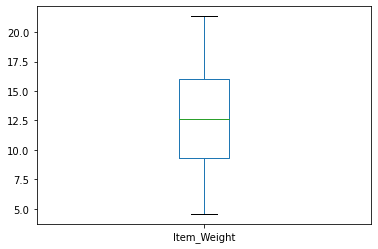

In [40]:
df_updated['Item_Weight'].plot.box()

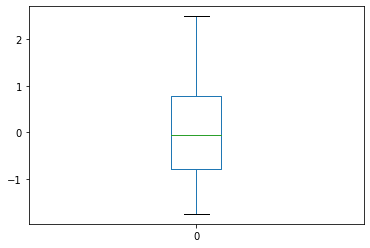

In [41]:
df_updated[0].plot.box()

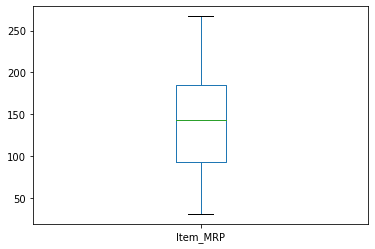

In [42]:
df_updated['Item_MRP'].plot.box()

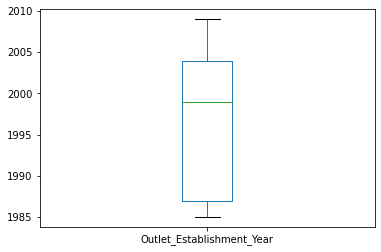

In [43]:
df_updated['Outlet_Establishment_Year'].plot.box()

No outliers are found

# Separating the independent and target variable in x and y

In [44]:
x=df_updated.drop('Item_Outlet_Sales',axis=1)
y=df_updated['Item_Outlet_Sales']

# Scaling the data using Standard Scaler

In [45]:
#from sklearn.preprocessing import StandardScaler
#scale=StandardScaler()
#x=scale.fit_transform(x)

# Finding Random State

In [46]:
maxAccu=0
maxRS=0
for i in range(1,500):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    predrf=lr.predict(x_test)
    acc=r2_score(y_test,predrf)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Best accuracy is',maxAccu,'on Random_state',maxRS)

Best accuracy is 0.5374618346722667 on Random_state 178


# Creating train_test_split

In [47]:
 x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.30,random_state=178)

In [48]:
x_train.shape

(5966, 11)

In [49]:
x_test.shape

(2557, 11)

In [50]:
y_train.shape

(5966,)

In [51]:
y_test.shape

(2557,)

In [52]:
lr.fit(x_train,y_train)

LinearRegression()

In [53]:
pred_test=lr.predict(x_test)

In [54]:
print(r2_score(y_test,pred_test))

0.5374618346722667


In [55]:
pred=lr.predict(x_test) 
print('Predicted result price:',pred) 
print('actual price:',y_test)

Predicted result price: [ 605.45859276 2721.0442531  4362.46998048 ... 2048.7922472  1484.76505786
 1474.64717814]
actual price: 3354      223.7088
5828     1577.9460
55       6258.5200
5246     1245.0460
7285     1290.3204
7400      671.1264
310      3848.3240
8159     1571.2880
6871       42.6112
1193     1571.2880
8357     1528.0110
6688     5888.3352
1490      486.0340
2973      870.8664
2913      982.0550
5761     5976.2208
2139      498.0184
2110     1949.4624
461       759.0120
6729     3338.9870
5387     2157.1920
762      1265.0200
7545     1635.8706
3435     5069.4012
3497      225.0404
6398     2607.2728
2439      171.1106
4659     2586.6330
7042     1398.1800
4707     3486.1288
8349     2936.1780
432       588.5672
6676     1597.9200
4015     1406.1696
7726     4637.9628
5010     2596.6200
2529     5972.2260
2683     1448.7808
8282     1640.5312
4681     8262.5780
1763     1001.3632
6102      379.5060
7434     3056.0220
2831     1837.6080
4677     1186.4556
3792     3091.97

In [56]:
print('error:')
print(mean_squared_error(y_test,pred))

error:
1365671.6015099436


In [57]:
print(r2_score(y_test,pred))

0.5374618346722667


In [58]:
from sklearn.svm import SVR
svr=SVR(kernel='linear')
svr.fit(x_train,y_train)

SVR(kernel='linear')

In [59]:
svr.score(x_train,y_train)

0.46912635165981664

In [60]:
pred_y=svr.predict(x_test)

In [61]:
print('error:')
print(mean_squared_error(y_test,pred_y))

error:
1479774.7741716441


In [62]:
print(r2_score(y_test,pred_y))

0.49881632715591806


# Cross Validation

In [63]:
from sklearn.model_selection import cross_val_score

In [64]:
lrscores=cross_val_score(lr,x,y,cv=5)
print('Cross validation score of linear regression model:',lrscores.mean())

Cross validation score of linear regression model: 0.5073190273418441


In [65]:
svrscores=cross_val_score(svr,x,y,cv=5)
print('Cross validation score of support vector regressor model:',svrscores.mean())

Cross validation score of support vector regressor model: 0.4809285653753722


The best model is Support Vector Regressor Model beacause the difference between r2_score and cross_val_score is(50-48=2) where in Linear Reggression the difference is more.

# Regularization

In [66]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Lasso
parameters={'alpha':[.0001,.001,.01,.1,1,10],'random_state':list(range(0,10))}
ls=Lasso()
clf=GridSearchCV(ls,parameters)
clf.fit(x_train,y_train)
print(clf.best_params_)

{'alpha': 1, 'random_state': 0}


In [67]:
ls=Lasso(alpha=1,random_state=0)
ls.fit(x_train,y_train)
ls.score(x_train,y_train)
pred_ls=ls.predict(x_test)
lss=r2_score(y_test,pred_ls)
lss

0.5373050057660885

In [68]:
cv_score=cross_val_score(ls,x,y,cv=5)
cv_mean=cv_score.mean()
cv_mean

0.5073209903890887

# Ensemble technique

In [69]:
#from sklearn.ensemble import RandomForestRegressor

In [70]:
#parameters={'criterion':['mse','mae'],'max_features':['auto','sqrt','log2']}
#rf=RandomForestRegressor()
#clf=GridSearchCV(rf,parameters)

In [71]:
#clf.fit(x_train,y_train)
#print(clf.best_params_)

In [72]:
#rf=RandomForestRegressor(criterion='mae',max_features='auto')
#rf.fit(x_train,y_train)
#rf.score(x_train,y_train)
#pred_decision=rf.predict(x_test)
#rfs=r2_score(y_test,pred_decision)
#print('r2_score:',rfs*100)
#rfscore=cross_val_score(rf,x,y,cv=5)
#rfc=rfscore.mean()
#print('Cross Val Score:',rfc*100)

# Hyperparameter tuning

In [73]:
#parameters={'kernel':['linear','rbf'],'C':[1,10]}
#svr=SVR()
#clf=GridSearchCV(svr,parameters)
#clf.fit(x_train,y_train)
#print(clf.best_params_)
#print(clf.best_score_)

In [123]:
#Saving the model
import pickle
filename='bigdatamart.pkl'
pickle.dump(svr,open(filename,'wb'))

# Using the test dataset

In [124]:
#loading the test data
test_df=pd.read_csv('bigdatamart_test.csv')

In [125]:
test_df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDW58,20.750,Low Fat,0.007565,Snack Foods,107.8622,OUT049,1999,Medium,Tier 1,Supermarket Type1
1,FDW14,8.300,reg,0.038428,Dairy,87.3198,OUT017,2007,NaN,Tier 2,Supermarket Type1
2,NCN55,14.600,Low Fat,0.099575,Others,241.7538,OUT010,1998,NaN,Tier 3,Grocery Store
3,FDQ58,7.315,Low Fat,0.015388,Snack Foods,155.0340,OUT017,2007,NaN,Tier 2,Supermarket Type1
4,FDY38,NaN,Regular,0.118599,Dairy,234.2300,OUT027,1985,Medium,Tier 3,Supermarket Type3


In [126]:
test_df.shape

(5681, 11)

In [127]:
test_df.columns

Index(['Item_Identifier', 'Item_Weight', 'Item_Fat_Content', 'Item_Visibility',
       'Item_Type', 'Item_MRP', 'Outlet_Identifier',
       'Outlet_Establishment_Year', 'Outlet_Size', 'Outlet_Location_Type',
       'Outlet_Type'],
      dtype='object')

In [128]:
test_df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
dtype: object

In [129]:
#checking the null values
test_df.isnull().sum()

Item_Identifier                 0
Item_Weight                   976
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  1606
Outlet_Location_Type            0
Outlet_Type                     0
dtype: int64

In [130]:
#By taking median and mode,we can remove null values
from sklearn.impute import SimpleImputer
imp=SimpleImputer(strategy='median')
test_df['Item_Weight']=imp.fit_transform(test_df['Item_Weight'].values.reshape(-1,1))

In [131]:
from sklearn.impute import SimpleImputer
imp=SimpleImputer(strategy='most_frequent')
test_df['Outlet_Size']=imp.fit_transform(test_df['Outlet_Size'].values.reshape(-1,1))

In [132]:
test_df.isnull().sum()

Item_Identifier              0
Item_Weight                  0
Item_Fat_Content             0
Item_Visibility              0
Item_Type                    0
Item_MRP                     0
Outlet_Identifier            0
Outlet_Establishment_Year    0
Outlet_Size                  0
Outlet_Location_Type         0
Outlet_Type                  0
dtype: int64

No null values are present

In [133]:
test_df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
dtype: object

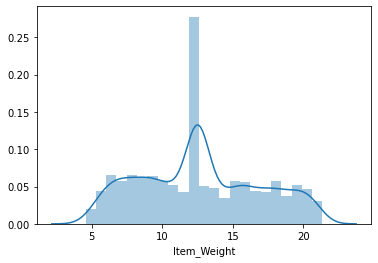

In [134]:
#Checking the distribution of the continuous value of the float type columns
sns.distplot(test_df['Item_Weight'],kde=True)

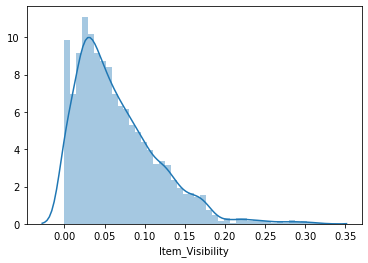

In [135]:
sns.distplot(test_df['Item_Visibility'],kde=True)

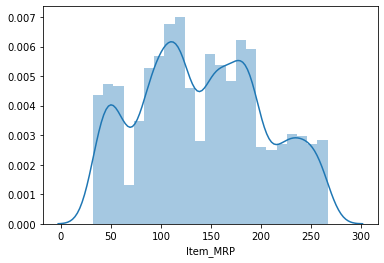

In [136]:
sns.distplot(test_df['Item_MRP'],kde=True)

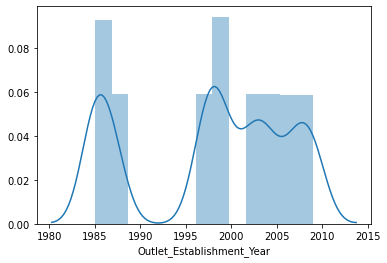

In [137]:
sns.distplot(test_df['Outlet_Establishment_Year'],kde=True)

In [138]:
#Encoding of dataframe
from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

In [139]:
for i in test_df.columns:
    if test_df[i].dtypes=='object':
        test_df[i]=enc.fit_transform(test_df[i].values.reshape(-1,1))

In [140]:
test_df

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,1103.0,20.750,1.0,0.007565,13.0,107.8622,9.0,1999,1.0,0.0,1.0
1,1067.0,8.300,4.0,0.038428,4.0,87.3198,2.0,2007,1.0,1.0,1.0
2,1406.0,14.600,1.0,0.099575,11.0,241.7538,0.0,1998,1.0,2.0,0.0
3,809.0,7.315,1.0,0.015388,13.0,155.0340,2.0,2007,1.0,1.0,1.0
4,1184.0,12.500,2.0,0.118599,4.0,234.2300,5.0,1985,1.0,2.0,3.0
5,461.0,9.800,2.0,0.063817,6.0,117.1492,8.0,1997,2.0,0.0,1.0
6,604.0,19.350,2.0,0.082602,0.0,50.1034,3.0,2009,1.0,2.0,2.0
7,266.0,12.500,1.0,0.015782,0.0,81.0592,5.0,1985,1.0,2.0,3.0
8,668.0,6.305,2.0,0.123365,13.0,95.7436,7.0,2002,1.0,1.0,1.0
9,170.0,5.985,1.0,0.005698,0.0,186.8924,2.0,2007,1.0,1.0,1.0


In [141]:
#Describe dataset
test_df.describe()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
count,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000,5681.000000
mean,773.386376,12.662023,1.368773,0.065684,7.233410,141.023273,4.722760,1997.828903,1.170921,1.112832,1.201373
std,445.525926,4.245831,0.641085,0.051252,4.219057,61.809091,2.837201,8.372256,0.600328,0.812824,0.796740
min,0.000000,4.555000,0.000000,0.000000,0.000000,31.990000,0.000000,1985.000000,0.000000,0.000000,0.000000
25%,382.000000,9.195000,1.000000,0.027047,4.000000,94.412000,2.000000,1987.000000,1.000000,0.000000,1.000000
50%,771.000000,12.500000,1.000000,0.054154,6.000000,141.415400,5.000000,1999.000000,1.000000,1.000000,1.000000
75%,1160.000000,15.850000,2.000000,0.093463,10.000000,186.026600,7.000000,2004.000000,2.000000,2.000000,1.000000
max,1542.000000,21.350000,4.000000,0.323637,15.000000,266.588400,9.000000,2009.000000,2.000000,2.000000,3.000000


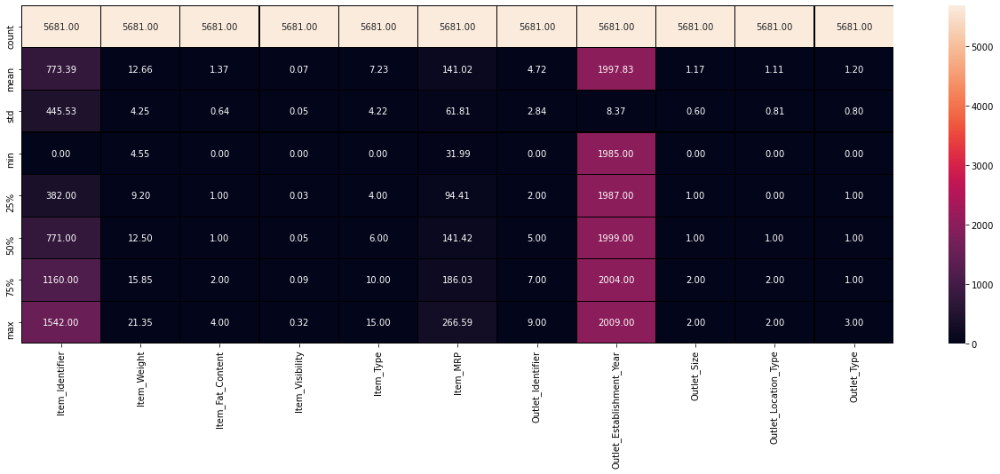

In [142]:
plt.figure(figsize=(22,7))
sns.heatmap(test_df.describe(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

In [143]:
#Checking correlation
test_df.corr()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
Item_Identifier,1.000000,0.051378,-0.093344,-0.063856,-0.003236,0.007537,0.010162,0.011728,0.004379,-0.011657,-0.009553
Item_Weight,0.051378,1.000000,-0.042772,-0.018342,0.029781,0.045048,0.020311,0.025678,0.012230,-0.012969,-0.002043
Item_Fat_Content,-0.093344,-0.042772,1.000000,0.033591,-0.128945,-0.014283,-0.000792,-0.010088,0.000421,-0.000130,0.000387
Item_Visibility,-0.063856,-0.018342,0.033591,1.000000,-0.036237,-0.014013,-0.114857,-0.097040,0.058082,-0.001146,-0.154042
Item_Type,-0.003236,0.029781,-0.128945,-0.036237,1.000000,0.060990,0.000333,0.000204,-0.003729,0.000584,0.006179
Item_MRP,0.007537,0.045048,-0.014283,-0.014013,0.060990,1.000000,-0.006412,-0.007233,-0.011717,0.001754,0.003326
Outlet_Identifier,0.010162,0.020311,-0.000792,-0.114857,0.000333,-0.006412,1.000000,0.079065,0.504545,-0.716113,0.099937
Outlet_Establishment_Year,0.011728,0.025678,-0.010088,-0.097040,0.000204,-0.007233,0.079065,1.000000,0.193397,-0.089496,-0.122841
Outlet_Size,0.004379,0.012230,0.000421,0.058082,-0.003729,-0.011717,0.504545,0.193397,1.000000,-0.614284,-0.201538
Outlet_Location_Type,-0.011657,-0.012969,-0.000130,-0.001146,0.000584,0.001754,-0.716113,-0.089496,-0.614284,1.000000,0.467299


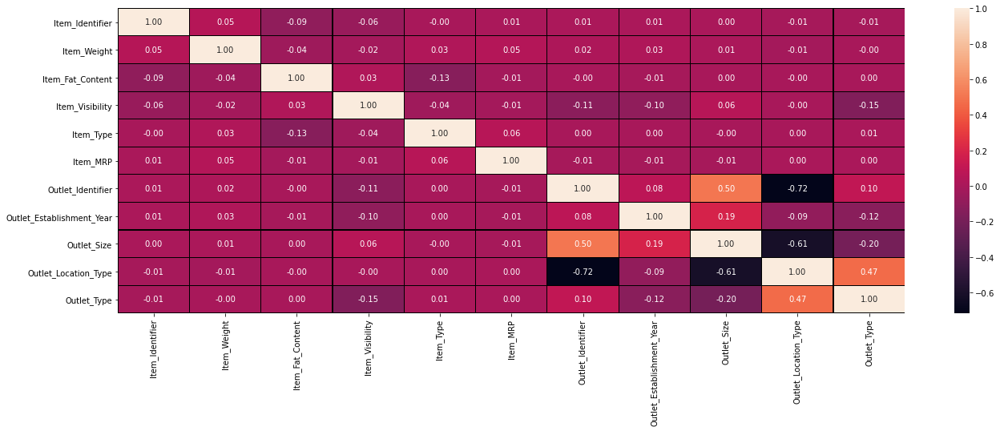

In [144]:
plt.figure(figsize=(22,7))
sns.heatmap(test_df.corr(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

In [145]:
#Checking skewness
test_df.skew()

Item_Identifier             -0.000020
Item_Weight                  0.166489
Item_Fat_Content             0.999629
Item_Visibility              1.238312
Item_Type                    0.096486
Item_MRP                     0.136182
Outlet_Identifier           -0.060209
Outlet_Establishment_Year   -0.396306
Outlet_Size                 -0.087108
Outlet_Location_Type        -0.209049
Outlet_Type                  0.927446
dtype: float64

Keeping +/-0.5 as the range for skewness,here are the columns which does not lie within this range.

We only have to remove skewness from a single column 'Item_Visibility' as it is a float type.We dont go for skewness removal if the column is object type.

In [146]:
from sklearn.preprocessing import PowerTransformer
test_df_new=PowerTransformer(method='yeo-johnson')
test_df_new1=test_df_new.fit_transform(test_df.iloc[:,3:4])

In [147]:
test_df_N=pd.DataFrame(test_df_new1)
test_df_N

,0
0,-1.462069
1,-0.448019
2,0.871342
3,-1.175927
4,1.153823
5,0.190626
6,0.575571
7,-1.162078
8,1.217491
9,-1.533601


In [148]:
test_df_N.skew()

0    0.116776
dtype: float64

In [149]:
test_df.drop(['Item_Visibility'],axis=1,inplace=True)

In [150]:
test_df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,1103.0,20.750,1.0,13.0,107.8622,9.0,1999,1.0,0.0,1.0
1,1067.0,8.300,4.0,4.0,87.3198,2.0,2007,1.0,1.0,1.0
2,1406.0,14.600,1.0,11.0,241.7538,0.0,1998,1.0,2.0,0.0
3,809.0,7.315,1.0,13.0,155.0340,2.0,2007,1.0,1.0,1.0
4,1184.0,12.500,2.0,4.0,234.2300,5.0,1985,1.0,2.0,3.0


In [151]:
test_df_updated=pd.concat([test_df,test_df_N],axis=1)

In [152]:
test_df_updated

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,0
0,1103.0,20.750,1.0,13.0,107.8622,9.0,1999,1.0,0.0,1.0,-1.462069
1,1067.0,8.300,4.0,4.0,87.3198,2.0,2007,1.0,1.0,1.0,-0.448019
2,1406.0,14.600,1.0,11.0,241.7538,0.0,1998,1.0,2.0,0.0,0.871342
3,809.0,7.315,1.0,13.0,155.0340,2.0,2007,1.0,1.0,1.0,-1.175927
4,1184.0,12.500,2.0,4.0,234.2300,5.0,1985,1.0,2.0,3.0,1.153823
5,461.0,9.800,2.0,6.0,117.1492,8.0,1997,2.0,0.0,1.0,0.190626
6,604.0,19.350,2.0,0.0,50.1034,3.0,2009,1.0,2.0,2.0,0.575571
7,266.0,12.500,1.0,0.0,81.0592,5.0,1985,1.0,2.0,3.0,-1.162078
8,668.0,6.305,2.0,13.0,95.7436,7.0,2002,1.0,1.0,1.0,1.217491
9,170.0,5.985,1.0,0.0,186.8924,2.0,2007,1.0,1.0,1.0,-1.533601


In [153]:
test_df_updated.dtypes

Item_Identifier              float64
Item_Weight                  float64
Item_Fat_Content             float64
Item_Type                    float64
Item_MRP                     float64
Outlet_Identifier            float64
Outlet_Establishment_Year      int64
Outlet_Size                  float64
Outlet_Location_Type         float64
Outlet_Type                  float64
0                            float64
dtype: object

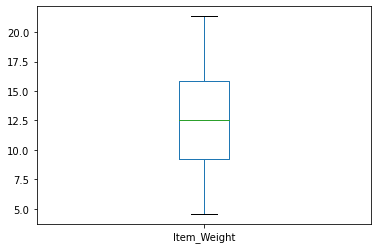

In [154]:
#Checking outliers
#Checking the outliers on the original int and float type of columns
test_df_updated['Item_Weight'].plot.box()

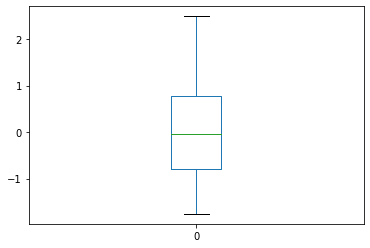

In [155]:
test_df_updated[0].plot.box()

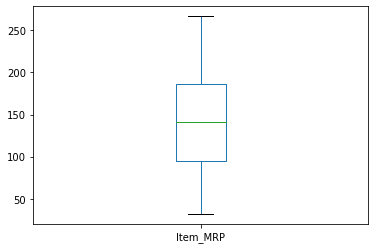

In [156]:
test_df_updated['Item_MRP'].plot.box()

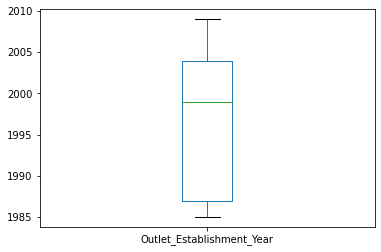

In [157]:
test_df_updated['Outlet_Establishment_Year'].plot.box()

No outliers are present

In [158]:
#Load the model
fitted_model=pickle.load(open("bigdatamart.pkl","rb"))

In [159]:
fitted_model

SVR(kernel='linear')

In [160]:
#Prediction over test data
predictions=fitted_model.predict(test_df_updated)

In [161]:
predictions

array([1951.58673963,  970.40067536, 2520.50469967, ..., 1837.4263512 ,
       2883.75939038, 1269.22924645])